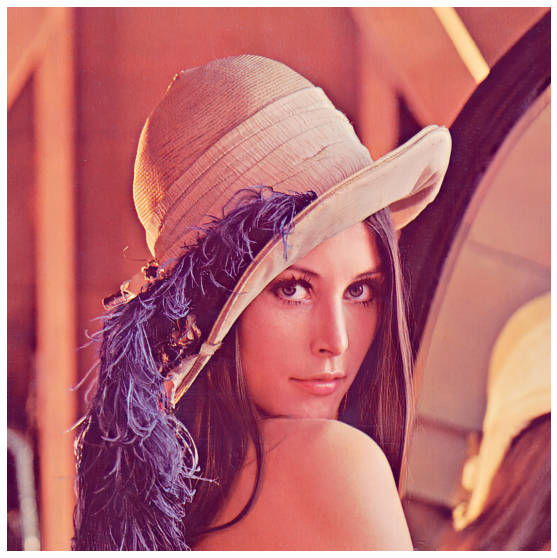

Calculating all tasks:   0%|          | 0/25 [00:00<?, ?it/s]

In [2]:
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import numpy as np
import cv2

def show(image):
    # plt.axis("off")
    # plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB), interpolation='nearest' )
    # plt.show()
    plt.figure(figsize=(10,10))
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

img = cv2.imread('Lenna.png')
show(img)
pbar = tqdm(total=25, desc="Calculating all tasks")


1. Find all ORB features on image

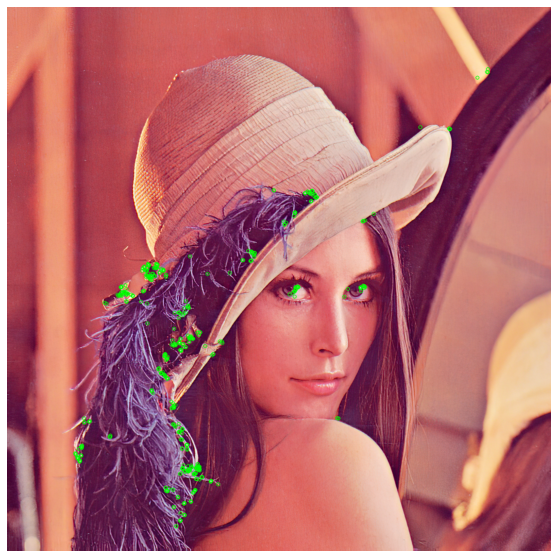

True

In [3]:
orb = cv2.ORB_create()
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
kp = orb.detect(gray,None)
kp, des = orb.compute(img, kp)
img2 = cv2.drawKeypoints(img, kp, None, color=(0,255,0), flags=0)
show(img2)
pbar.update(1)

2. Find all SIFT features on image

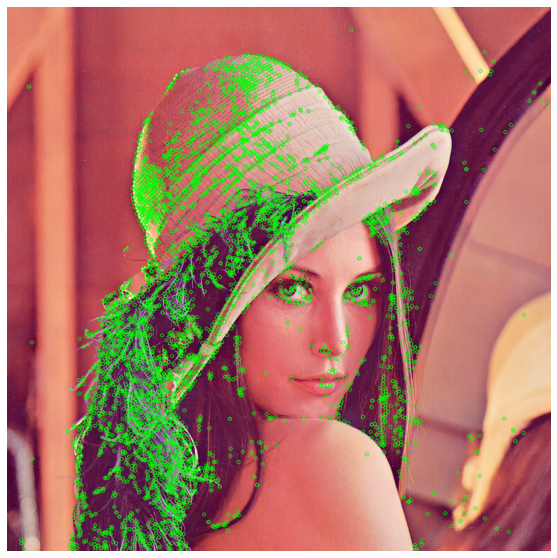

True

In [4]:
sift = cv2.SIFT_create()
kp = sift.detect(img,None)
kp, des = sift.compute(img, kp)
img2 = cv2.drawKeypoints(img, kp, None, color=(0,255,0), flags=0)
show(img2)
pbar.update(1)

3. Find canny edges on image

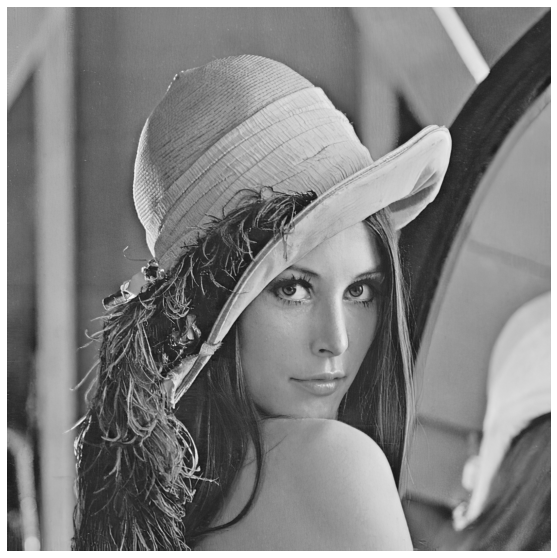

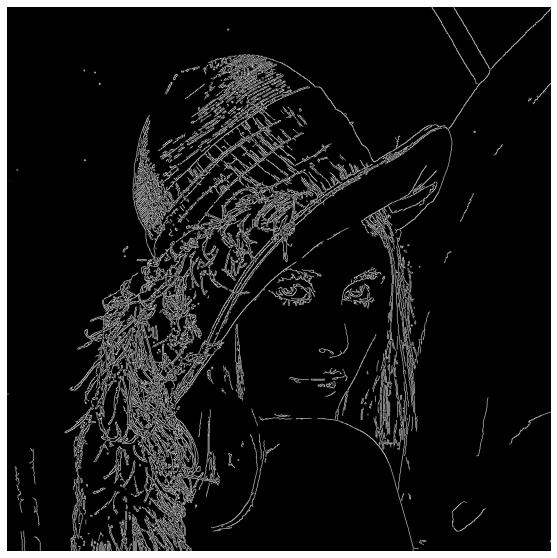

True

In [5]:
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
edges = cv2.Canny(gray,100,200)
show(gray)
show(edges)
pbar.update(1)
# plt.subplot(121),plt.imshow(gray,cmap = 'gray')
# plt.title('Original Image'), plt.xticks([]), plt.yticks([])
# plt.subplot(122),plt.imshow(edges,cmap = 'gray')
# plt.title('Edge Image'), plt.xticks([]), plt.yticks([])

4. Convert image to grayscale

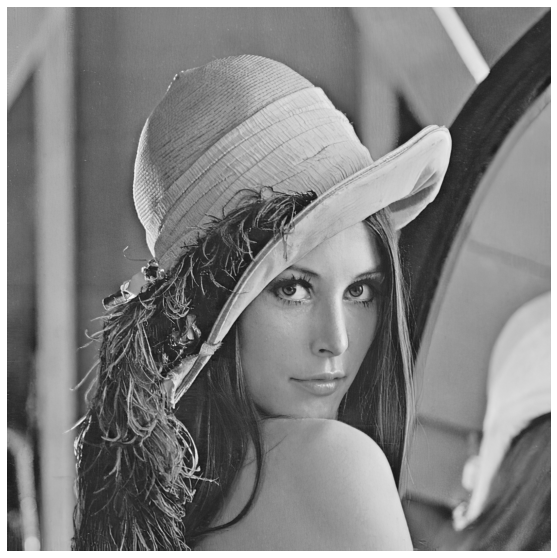

True

In [6]:
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
show(gray)
pbar.update(1)

5. Convert image to hsv

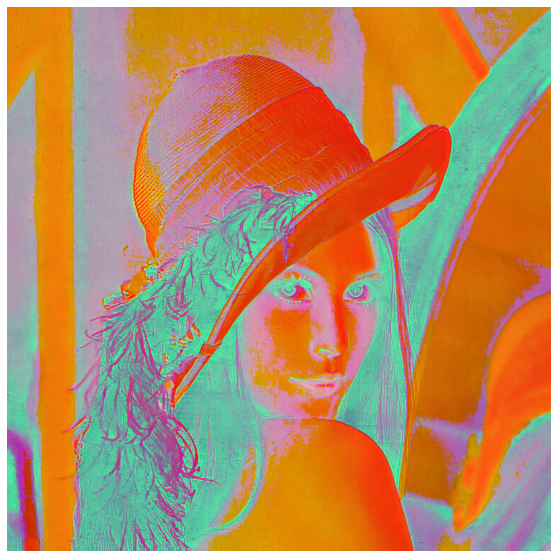

True

In [7]:
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
show(hsv)
pbar.update(1)

6. Reflect image on the right boner

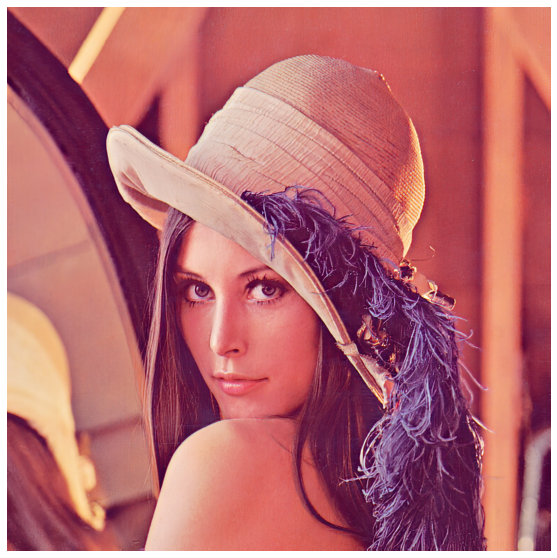

True

In [8]:
ref = cv2.flip(img, 2)
show(ref)
pbar.update(1)

7. Reflect image on the bottom boner


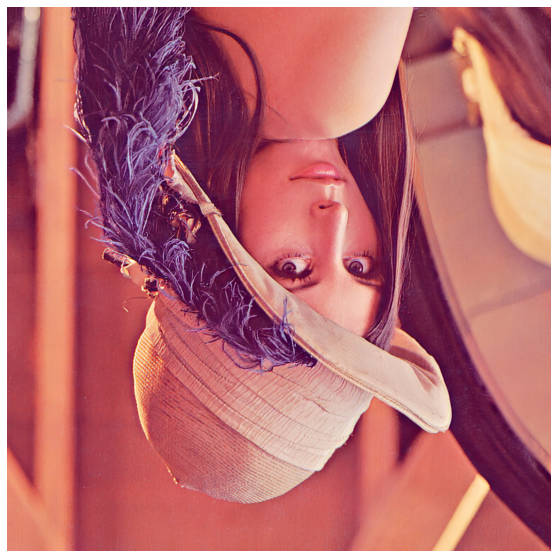

True

In [9]:
ref = cv2.flip(img, 0)
show(ref)
pbar.update(1)

8. Rotate image to 45 degrees

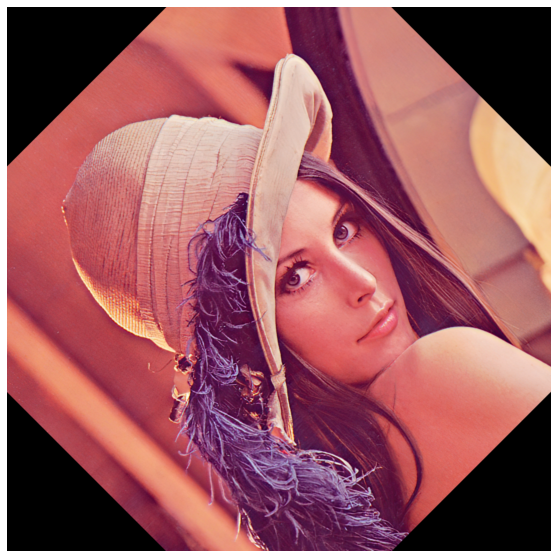

True

In [10]:

def rotate_image(image, angle):
  image_center = tuple(np.array(image.shape[1::-1]) / 2)
  rot_mat = cv2.getRotationMatrix2D(image_center, angle, 1.0)
  result = cv2.warpAffine(image, rot_mat, image.shape[1::-1], flags=cv2.INTER_LINEAR)
  return result

rot = rotate_image(img,45)
show(rot)
pbar.update(1)

9. Rotate image on 30 degrees around point

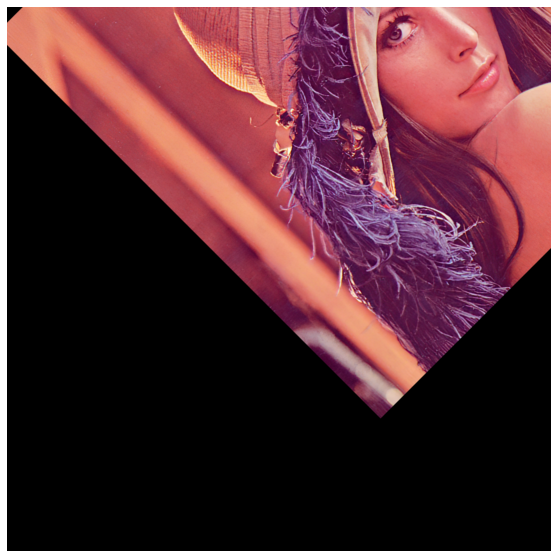

True

In [11]:
def rotate_image(image, angle, point):
  #image_center = tuple(point / 2)
  rot_mat = cv2.getRotationMatrix2D(point, angle, 1.0)
  result = cv2.warpAffine(image, rot_mat, image.shape[1::-1], flags=cv2.INTER_LINEAR)
  return result

rot = rotate_image(img,45,(50, 50))
show(rot)
pbar.update(1)

10. Shift the image but 10 pixels to the right

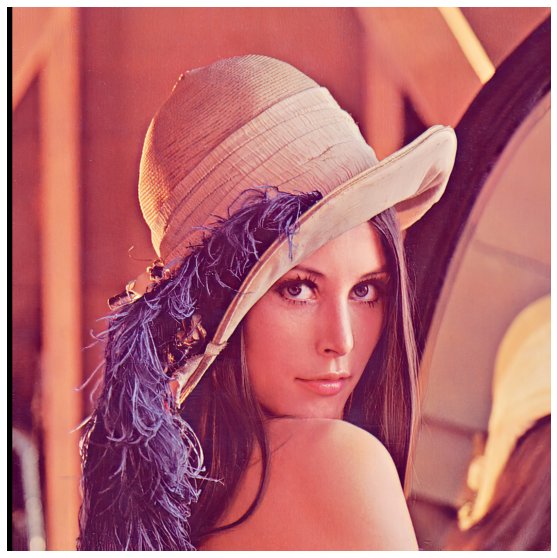

True

In [12]:
M = np.float32([
	[1, 0, 10],
	[0, 1, 0]
])
shifted = cv2.warpAffine(img, M, (img.shape[1], img.shape[0]))
show(shifted)
pbar.update(1)

11. Change image brightness

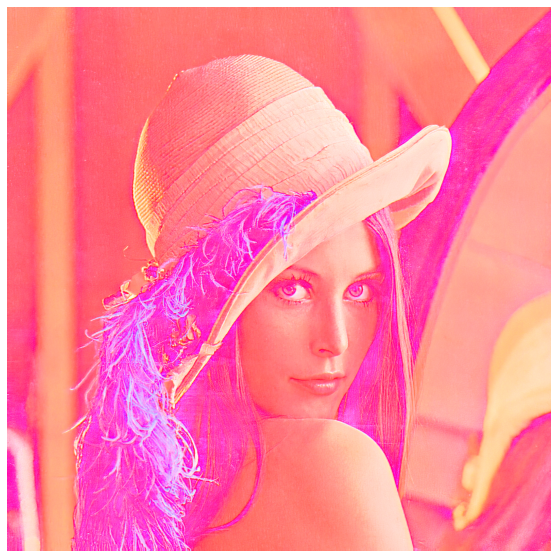

True

In [13]:
def increase_brightness(img, value=30):
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    h, s, v = cv2.split(hsv)

    lim = 255 - value
    v[v > lim] = 255
    v[v <= lim] += value

    final_hsv = cv2.merge((h, s, v))
    img = cv2.cvtColor(final_hsv, cv2.COLOR_HSV2BGR)
    return img

bri = increase_brightness(img,250)
show(bri)
pbar.update(1)

12. Change image contrast

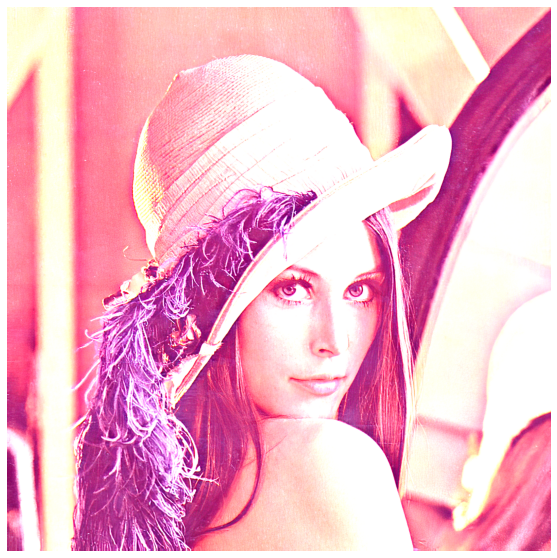

True

In [14]:
alpha = 2 # Contrast control (1.0-3.0)
beta = 0 # Brightness control (0-100)

res = cv2.convertScaleAbs(img, alpha=alpha, beta=beta)
show(res)
pbar.update(1)

13. Do a gamma transform

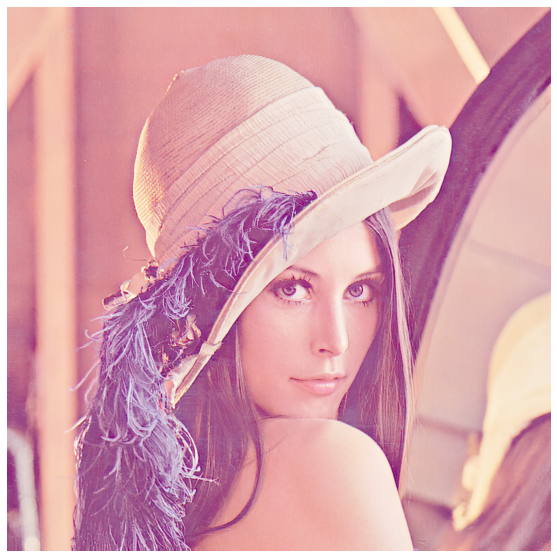

True

In [15]:
def gammaCorrection(src, gamma):
    invGamma = 1 / gamma

    table = [((i / 255) ** invGamma) * 255 for i in range(256)]
    table = np.array(table, np.uint8)

    return cv2.LUT(src, table)

gammaImg = gammaCorrection(img, 2.2)
show(gammaImg)
pbar.update(1)

14. Do a histogram equalization

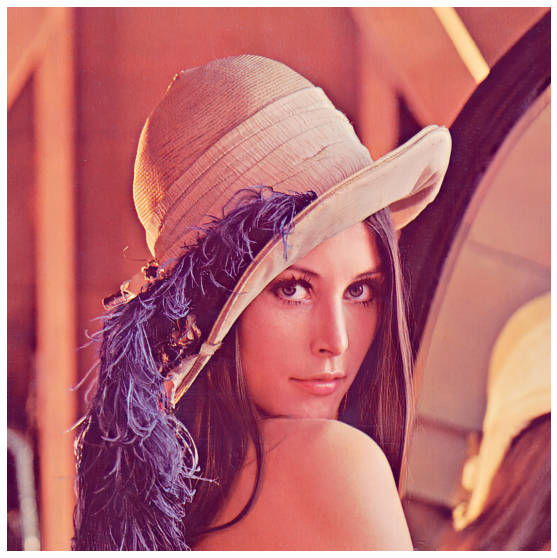

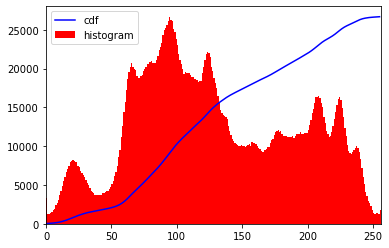

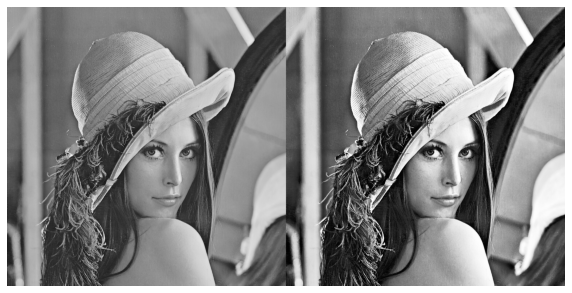

True

In [16]:
show(img)
hist,bins = np.histogram(img.flatten(),256,[0,256])
cdf = hist.cumsum()
cdf_normalized = cdf * float(hist.max()) / cdf.max()
plt.plot(cdf_normalized, color = 'b')
plt.hist(img.flatten(),256,[0,256], color = 'r')
plt.xlim([0,256])
plt.legend(('cdf','histogram'), loc = 'upper left')
plt.show()

gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
equ = cv2.equalizeHist(gray)
res = np.hstack((gray,equ))
show(res)
pbar.update(1)

15. Change the white balance, make a "warmer" picture

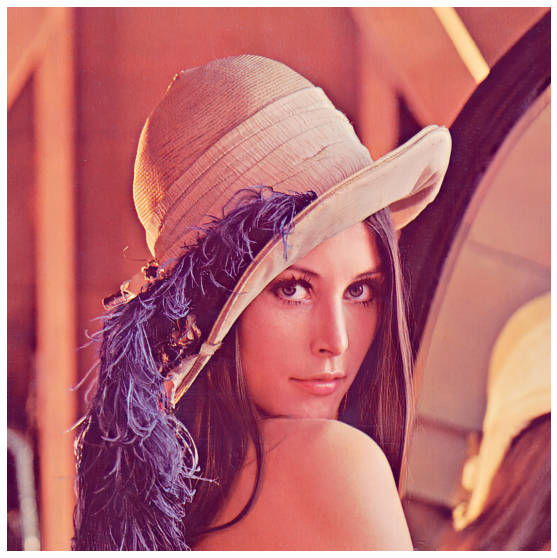

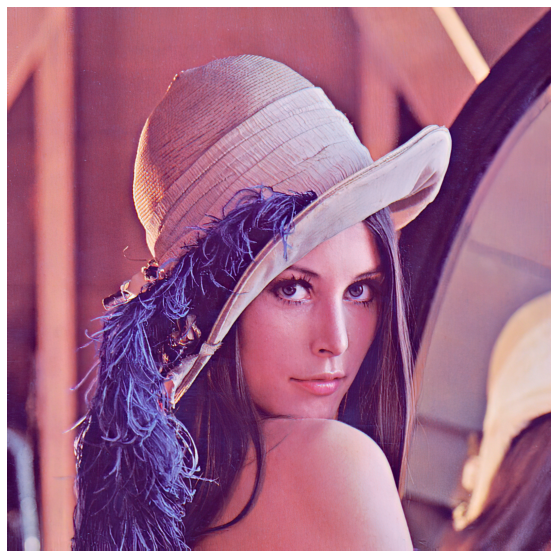

True

In [17]:
from scipy.interpolate import UnivariateSpline

def spreadLookupTable(x, y):
  spline = UnivariateSpline(x, y)
  return spline(range(256))

def warmImage(image):
    increaseLookupTable = spreadLookupTable([0, 64, 128, 256], [0, 80, 160, 256])
    decreaseLookupTable = spreadLookupTable([0, 64, 128, 256], [0, 50, 100, 256])
    red_channel, green_channel, blue_channel = cv2.split(image)
    red_channel = cv2.LUT(red_channel, increaseLookupTable).astype(np.uint8)
    blue_channel = cv2.LUT(blue_channel, decreaseLookupTable).astype(np.uint8)
    return cv2.merge((red_channel, green_channel, blue_channel))


warm = warmImage(img)
show(img)
show(warm)
pbar.update(1)

16. Change the white balance, make a "colder" picture

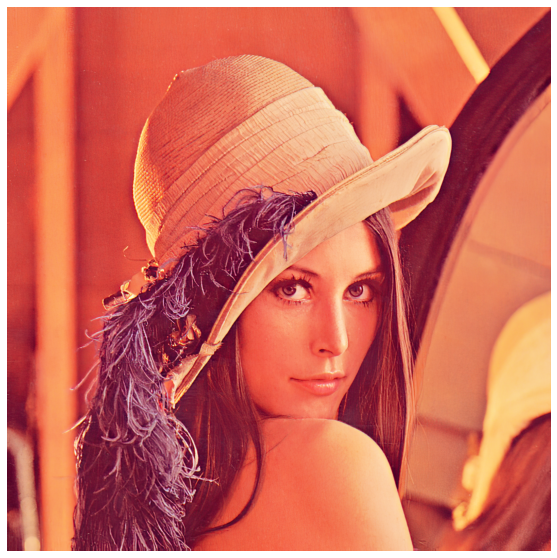

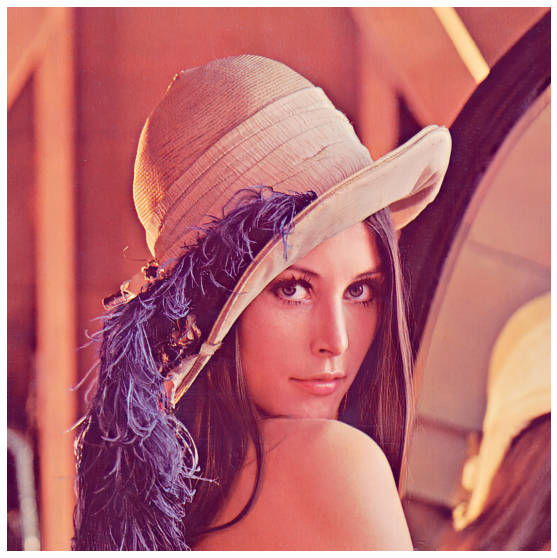

True

In [18]:
from scipy.interpolate import UnivariateSpline

def spreadLookupTable(x, y):
  spline = UnivariateSpline(x, y)
  return spline(range(256))

def coldImage(image):
    increaseLookupTable = spreadLookupTable([0, 64, 128, 256], [0, 80, 160, 256])
    decreaseLookupTable = spreadLookupTable([0, 64, 128, 256], [0, 50, 100, 256])
    red_channel, green_channel, blue_channel = cv2.split(image)
    red_channel = cv2.LUT(red_channel, decreaseLookupTable).astype(np.uint8)
    blue_channel = cv2.LUT(blue_channel, increaseLookupTable).astype(np.uint8)
    return cv2.merge((red_channel, green_channel, blue_channel))

cold = coldImage(img)
show(cold)
show(img)
pbar.update(1)

17. Change the color palette according to the given template

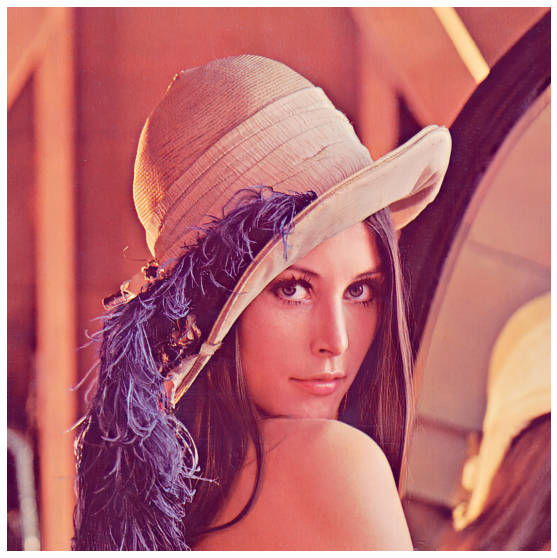

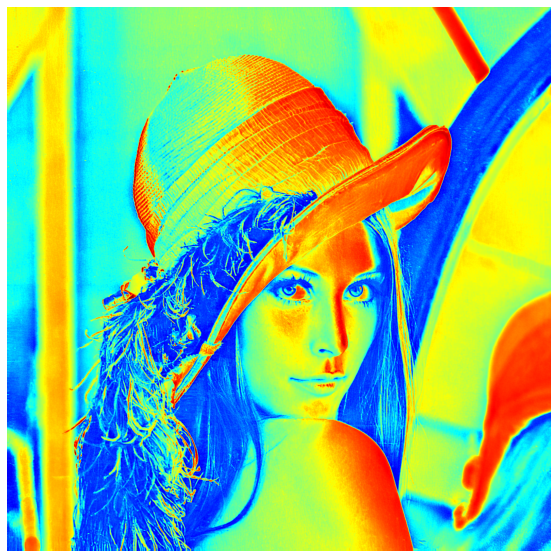

True

In [19]:
imC = cv2.applyColorMap(img, cv2.COLORMAP_JET)
show(img)
show(imC)
pbar.update(1)

18. Do image binarization

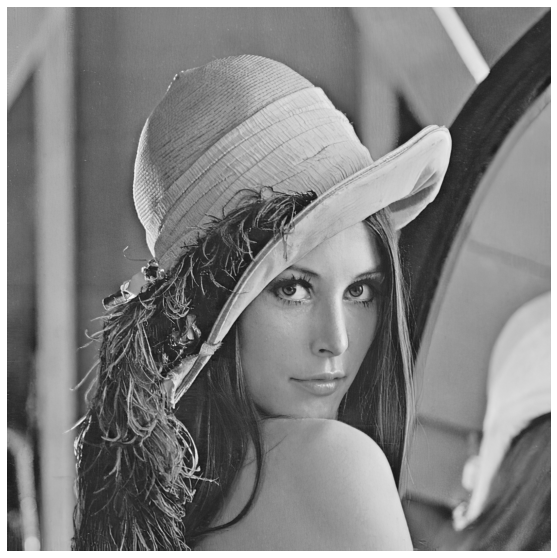

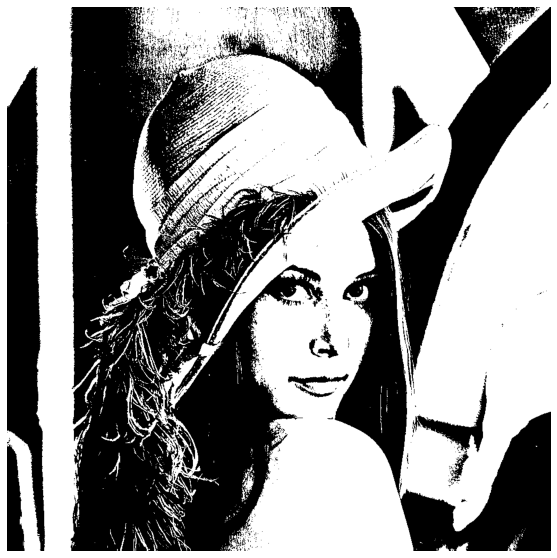

True

In [20]:
thresh = 125
maxval = 255
ret, thresh1 = cv2.threshold(gray, thresh, maxval, cv2.THRESH_BINARY)
show(gray)
show(thresh1)
pbar.update(1)

19. Find contours in binarized image

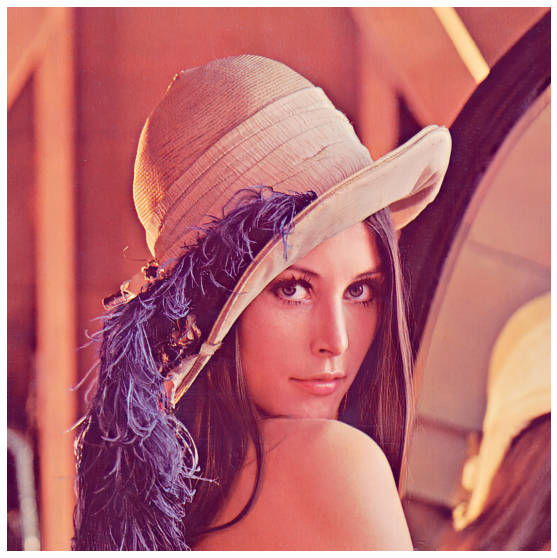

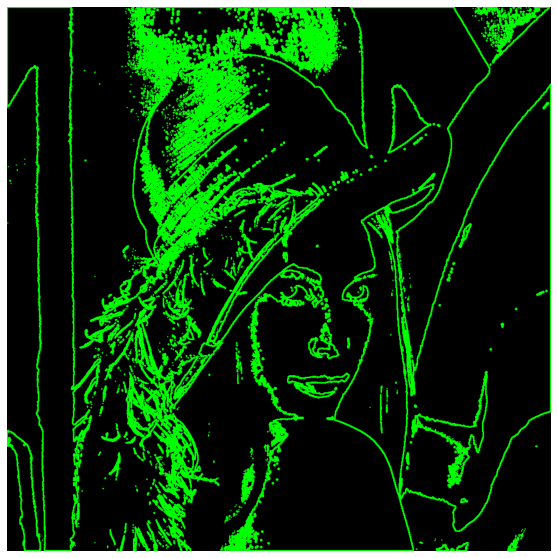

True

In [21]:
_, binary = cv2.threshold(gray, 125, 255, cv2.THRESH_BINARY)
contours, hierarchy = cv2.findContours(binary, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
height, width, channels = img.shape
im1 = blank_image = np.zeros((height,width,3), np.uint8)
im1 = cv2.drawContours(im1, contours, -1, (0, 255, 0), 2)

show(img)
show(im1)
pbar.update(1)

20. Find contours in the image by applying filters (Sobel or Laplacian)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


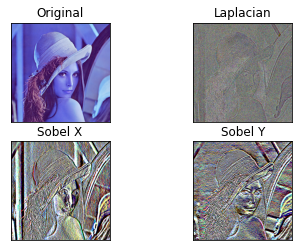

True

In [22]:
laplacian = cv2.Laplacian(img,cv2.CV_64F)
sobelx = cv2.Sobel(img,cv2.CV_64F,1,0,ksize=5)  # x
sobely = cv2.Sobel(img,cv2.CV_64F,0,1,ksize=5)  # y

plt.subplot(2,2,1),plt.imshow(img,cmap = 'gray')
plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(2,2,2),plt.imshow(laplacian,cmap = 'gray')
plt.title('Laplacian'), plt.xticks([]), plt.yticks([])
plt.subplot(2,2,3),plt.imshow(sobelx,cmap = 'gray')
plt.title('Sobel X'), plt.xticks([]), plt.yticks([])
plt.subplot(2,2,4),plt.imshow(sobely,cmap = 'gray')
plt.title('Sobel Y'), plt.xticks([]), plt.yticks([])

plt.show()
pbar.update(1)

21. Make image blur

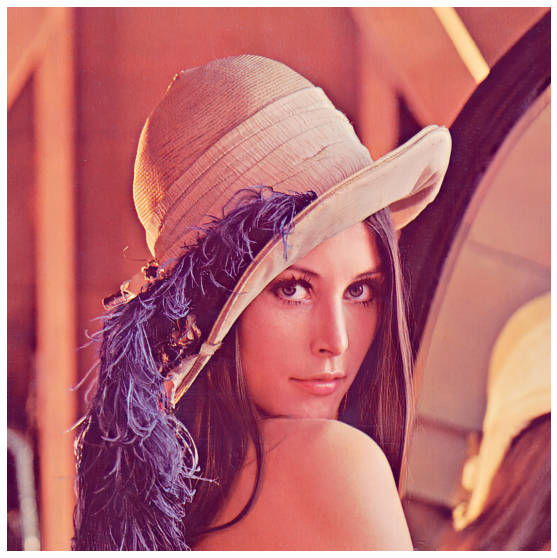

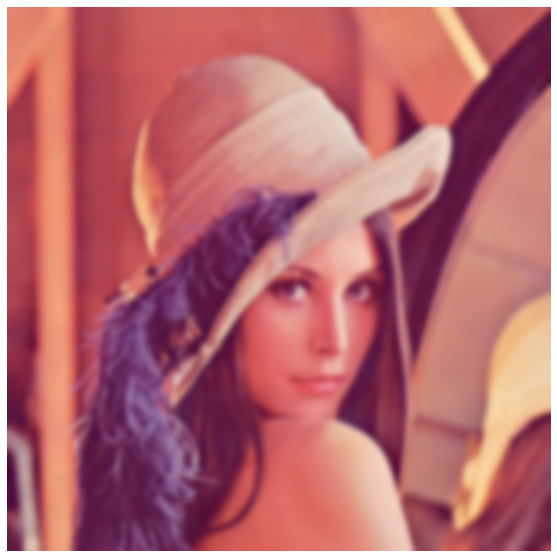

True

In [23]:
blur_image = cv2.GaussianBlur(img, (35,35), 0)
show(img)
show(blur_image)
pbar.update(1)

22. Filter the image using the Fourier transform, leave only fast frequencies

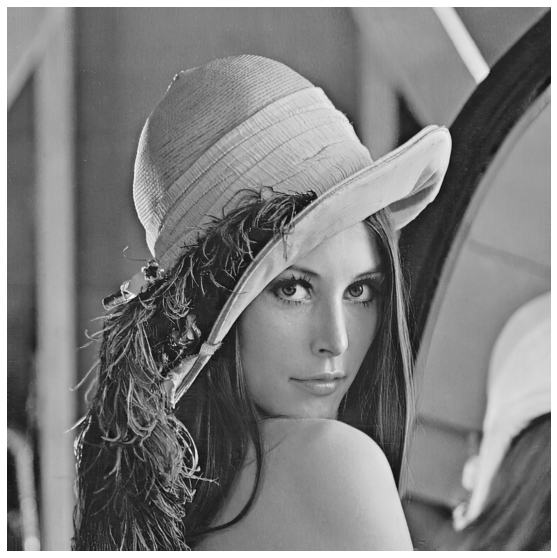

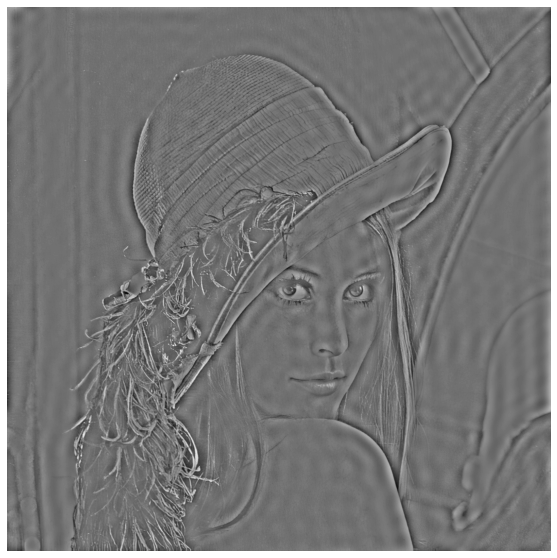

True

In [24]:
import scipy.fftpack as fp


F1 = fp.fft2((gray).astype(float))
F2 = fp.fftshift(F1)
w, h = gray.shape
half_w, half_h = int(w/2), int(h/2)

# high pass filter
n = 25
F2[half_w-n:half_w+n+1,half_h-n:half_h+n+1] = 0 # select all but the first 50x50 (low) frequencies
im1 = fp.ifft2(fp.ifftshift(F2)).real
plt.figure(figsize=(10,10))
plt.imshow(gray, cmap=plt.cm.gray)
plt.axis('off')
plt.show()

plt.figure(figsize=(10,10))
plt.imshow(im1, cmap='gray')
plt.axis('off')
plt.show()
pbar.update(1)

23. Filter the image using the Fourier transform, leave only fast frequencies

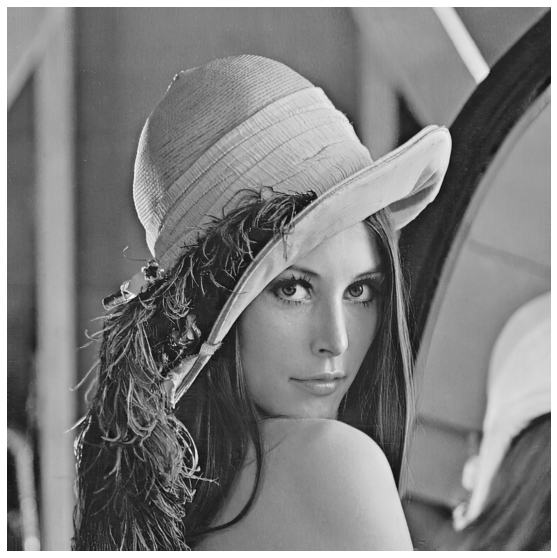

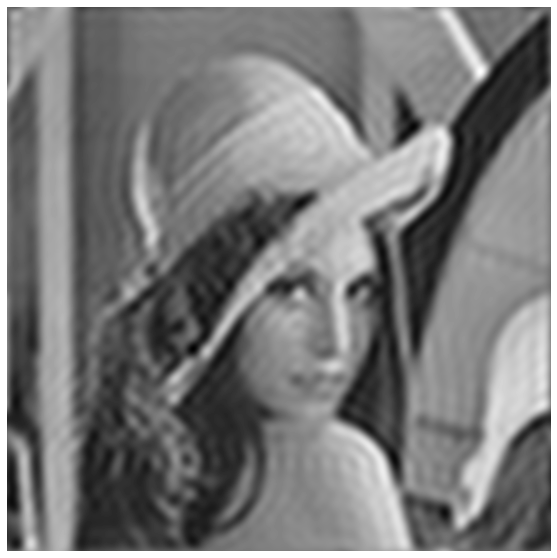

True

In [25]:

dft = cv2.dft(np.float32(gray),flags = cv2.DFT_COMPLEX_OUTPUT)
dft_shift = np.fft.fftshift(dft)
magnitude_spectrum = 20*np.log(cv2.magnitude(dft_shift[:,:,0],dft_shift[:,:,1]))

rows, cols, _ = img.shape
crow,ccol = round(rows/2) , round(cols/2)
# create a mask first, center square is 1, remaining all zeros
mask = np.zeros((rows,cols,2),np.uint8)
mask[crow-30:crow+30, ccol-30:ccol+30] = 1
# apply mask and inverse DFT
fshift = dft_shift*mask
f_ishift = np.fft.ifftshift(fshift)
img_back = cv2.idft(f_ishift)
img_back = cv2.magnitude(img_back[:,:,0],img_back[:,:,1])
# plt.subplot(121),plt.imshow(gray, cmap = 'gray')
# plt.title('Input Image'), plt.xticks([]), plt.yticks([])
# plt.subplot(122),plt.imshow(img_back, cmap = 'gray')
# plt.title('Low Pass Filtering '), plt.xticks([]), plt.yticks([])
# plt.show()
plt.figure(figsize=(10,10))
plt.imshow(gray, cmap='gray')
plt.axis('off')
plt.show()
plt.figure(figsize=(10,10))
plt.imshow(img_back, cmap='gray')
plt.axis('off')
plt.show()

pbar.update(1)

24. Apply an erosion operation to the image

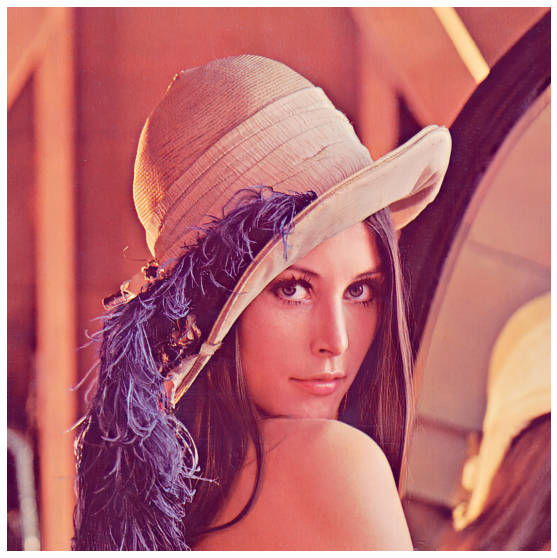

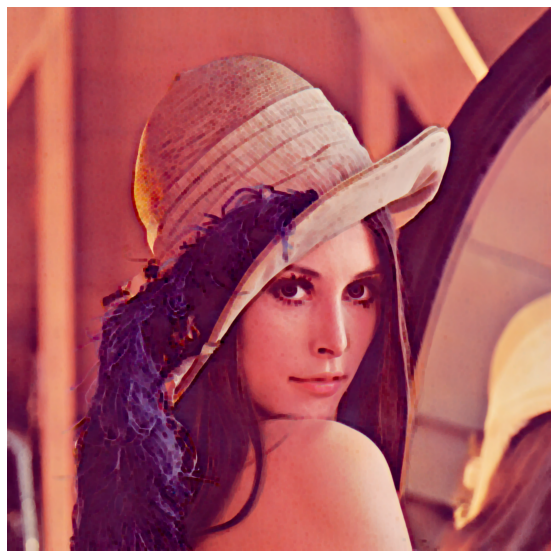

True

In [26]:
kernel = np.ones((5,5),np.uint8)
erosion = cv2.erode(img,kernel,iterations = 1)
show(img)
show(erosion)
pbar.update(1)

25. Apply the dilation operation to the image

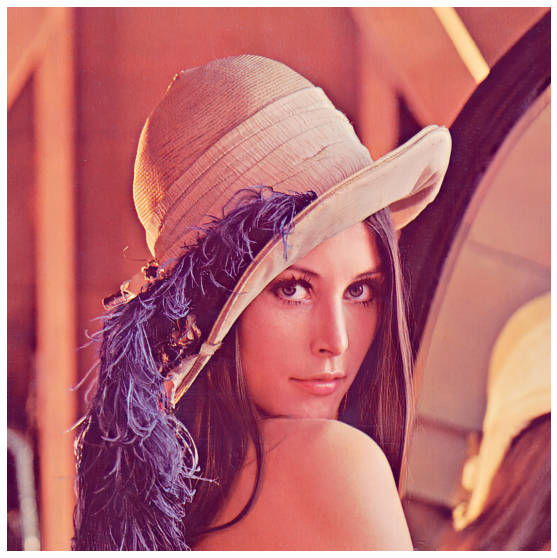

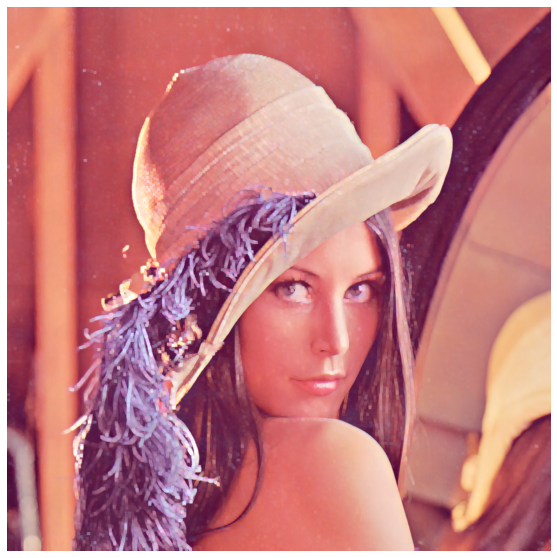

True

In [27]:
kernel = np.ones((5, 5), 'uint8')
dilate_img = cv2.dilate(img, kernel, iterations=1)
show(img)
show(dilate_img)
pbar.update(1)

In [28]:
pbar.close()
print("Done")

Done
